<a href="https://colab.research.google.com/github/shishirsingh645/MACHINE-LEARNING/blob/main/DECISSION_AND_LOGISTIC_REGRESSION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#import necessary libraries
import pandas as pd
import numpy as np
import sklearn.linear_model
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#read csv file
data=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/ML CLASS/modis_2022_India.csv')

In [ ]:
data

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,30.1138,80.0756,300.0,1.2,1.1,01-01-2022,511,Terra,MODIS,7,6.03,288.4,7.1,D,0
1,23.7726,86.2078,306.1,1.6,1.2,01-01-2022,512,Terra,MODIS,62,6.03,293.5,10.4,D,2
2,22.2080,84.8627,304.8,1.4,1.2,01-01-2022,512,Terra,MODIS,42,6.03,293.3,5.8,D,2
3,23.7621,86.3946,306.9,1.6,1.2,01-01-2022,512,Terra,MODIS,38,6.03,295.2,9.3,D,2
4,23.6787,86.0891,303.6,1.5,1.2,01-01-2022,512,Terra,MODIS,52,6.03,293.1,7.2,D,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81520,29.9033,74.9521,303.3,2.7,1.6,31-12-2022,1726,Terra,MODIS,55,6.03,281.3,37.2,N,0
81521,29.9086,74.9460,323.9,2.7,1.6,31-12-2022,1726,Terra,MODIS,100,6.03,282.0,106.5,N,0
81522,29.9170,74.9576,323.5,1.9,1.3,31-12-2022,2127,Aqua,MODIS,100,6.03,274.6,66.9,N,0
81523,21.1048,72.6415,302.9,2.0,1.4,31-12-2022,2130,Aqua,MODIS,52,6.03,289.9,18.5,N,2


In [ ]:
data.columns

Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_date',
       'acq_time', 'satellite', 'instrument', 'confidence', 'version',
       'bright_t31', 'frp', 'daynight', 'type'],
      dtype='object')

In [ ]:
data.isnull().sum()

,0
latitude,0
longitude,0
brightness,0
scan,0
track,0
acq_date,0
acq_time,0
satellite,0
instrument,0
confidence,0


In [ ]:
data['daynight'].value_counts()

,count
daynight,
D,71060
N,10465


In [ ]:
data['daynight']

,daynight
0,D
1,D
2,D
3,D
4,D
...,...
81520,N
81521,N
81522,N
81523,N


In [ ]:
from sklearn.preprocessing import LabelEncoder
data['daynight']=LabelEncoder().fit_transform(data['daynight'])
data['daynight']

,daynight
0,0
1,0
2,0
3,0
4,0
...,...
81520,1
81521,1
81522,1
81523,1


In [ ]:
data.dtypes

,0
latitude,float64
longitude,float64
brightness,float64
scan,float64
track,float64
acq_date,object
acq_time,int64
satellite,object
instrument,object
confidence,int64


In [ ]:
data['satellite']=LabelEncoder().fit_transform(data['satellite'])
data['instrument']=LabelEncoder().fit_transform(data['instrument'])
data.dtypes

,0
latitude,float64
longitude,float64
brightness,float64
scan,float64
track,float64
acq_date,object
acq_time,int64
satellite,int64
instrument,int64
confidence,int64


In [ ]:
data['acq_date'] = pd.to_datetime(data['acq_date'], format='%d-%m-%Y')
data.dtypes

,0
latitude,float64
longitude,float64
brightness,float64
scan,float64
track,float64
acq_date,datetime64[ns]
acq_time,int64
satellite,int64
instrument,int64
confidence,int64


In [ ]:
data.corr()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
latitude,1.000000,-0.048808,0.001594,0.034035,0.035661,0.318272,-0.098750,-0.207776,NaN,0.050071,NaN,-0.046786,0.004114,-0.167155,-0.098170
longitude,-0.048808,1.000000,0.119266,0.183558,0.180625,-0.327278,-0.172113,-0.172486,NaN,0.098955,NaN,-0.168192,0.217012,-0.108833,0.064490
brightness,0.001594,0.119266,1.000000,0.015038,0.019985,-0.249587,-0.374042,-0.207317,NaN,0.558649,NaN,0.629658,0.551700,-0.407549,-0.168160
scan,0.034035,0.183558,0.015038,1.000000,0.979123,-0.104864,-0.060744,-0.060267,NaN,-0.009285,NaN,-0.113446,0.281123,-0.055096,-0.048219
track,0.035661,0.180625,0.019985,0.979123,1.000000,-0.107509,-0.061767,-0.061848,NaN,-0.007875,NaN,-0.105274,0.274263,-0.055948,-0.048176
acq_date,0.318272,-0.327278,-0.249587,-0.104864,-0.107509,1.000000,-0.020400,-0.172739,NaN,-0.123317,NaN,-0.222423,-0.114292,-0.115179,0.077107
acq_time,-0.098750,-0.172113,-0.374042,-0.060744,-0.061767,-0.020400,1.000000,0.070053,NaN,0.003810,NaN,-0.437898,-0.071674,0.934475,0.166383
satellite,-0.207776,-0.172486,-0.207317,-0.060267,-0.061848,-0.172739,0.070053,1.000000,NaN,-0.059640,NaN,-0.142532,-0.089240,0.393554,0.115919
instrument,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
confidence,0.050071,0.098955,0.558649,-0.009285,-0.007875,-0.123317,0.003810,-0.059640,NaN,1.000000,NaN,0.204496,0.275506,-0.003348,-0.122278


In [ ]:
x = data[['frp', 'scan', 'brightness', 'track', 'bright_t31', 'type']]
y = data['daynight']

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
x=StandardScaler().fit_transform(x)
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.2,random_state=42)
model=LogisticRegression().fit(xtrain,ytrain)
pred=model.predict(xtest)

In [ ]:
pred

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(ytest,pred)

array([[13764,   443],
       [  815,  1283]])

In [ ]:
from sklearn.metrics import classification_report
classification_report(ytest,pred)

'              precision    recall  f1-score   support\n\n           0       0.94      0.97      0.96     14207\n           1       0.74      0.61      0.67      2098\n\n    accuracy                           0.92     16305\n   macro avg       0.84      0.79      0.81     16305\nweighted avg       0.92      0.92      0.92     16305\n'

### DECISION TREE

In [ ]:

from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
#  Decision Tree
dt_model = DecisionTreeClassifier()

dt_model.fit(xtrain, ytrain)

dt_pred = dt_model.predict(xtest)

print("Decision Tree Classifier Accuracy:", accuracy_score(ytest, dt_pred))
print("Confusion Matrix:\n", confusion_matrix(ytest, dt_pred))
print("Classification Report:\n", classification_report(ytest, dt_pred))

Decision Tree Classifier Accuracy: 0.9338239803741184
Confusion Matrix:
 [[13675   532]
 [  547  1551]]
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.96      0.96     14207
           1       0.74      0.74      0.74      2098

    accuracy                           0.93     16305
   macro avg       0.85      0.85      0.85     16305
weighted avg       0.93      0.93      0.93     16305



In [ ]:
cm = confusion_matrix(ytest, dt_pred)
print("Confusion Matrix:\n", cm)

Confusion Matrix:
 [[13675   532]
 [  547  1551]]


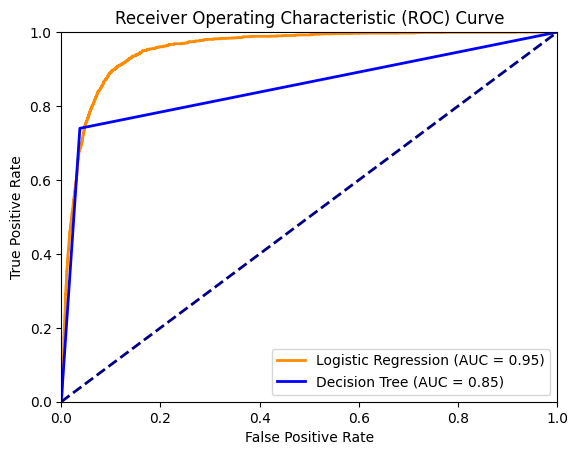

In [ ]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

y_predlr = model.predict_proba(xtest)[:, 1]

y_preddt = dt_model.predict_proba(xtest)[:, 1]

fpr_lr, tpr_lr, thresholds_lr = roc_curve(ytest, y_predlr)
roc_auc_lr = auc(fpr_lr, tpr_lr)


fpr_dt, tpr_dt, thresholds_dt = roc_curve(ytest, y_preddt)
roc_auc_dt = auc(fpr_dt, tpr_dt)

plt.figure()
plt.plot(fpr_lr, tpr_lr, color='darkorange', lw=2, label='Logistic Regression (AUC = %0.2f)' % roc_auc_lr)
plt.plot(fpr_dt, tpr_dt, color='blue', lw=2, label='Decision Tree (AUC = %0.2f)' % roc_auc_dt)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

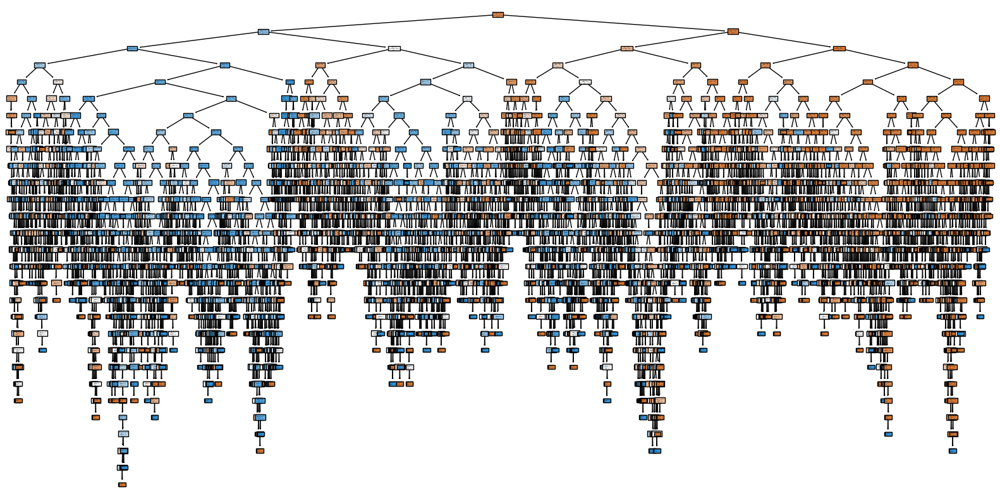

In [ ]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plot_tree(dt_model, filled=True, feature_names=['frp', 'scan', 'brightness', 'track', 'bright_t31', 'type'], class_names=['0', '1'])
plt.show()

In [ ]:
test_indices = ytest.index

results_df = pd.DataFrame({'latitude': data.loc[test_indices, 'latitude'],
                            'longitude': data.loc[test_indices, 'longitude'],
                            'predicted_daynight': dt_pred})
#df save
results_df.to_csv('predicted_results1.csv', index=False)

# visualize the map

In [ ]:
import folium
from folium.plugins import MarkerCluster

map_center = [20.5937, 78.9629]
my_map = folium.Map(location=map_center, zoom_start=5)

marker_cluster = MarkerCluster().add_to(my_map)

for index, row in results_df.iterrows():
  lat = row['latitude']
  lon = row['longitude']
  daynight = row['predicted_daynight']

  if daynight == 0:
    color = 'blue'
  else:
    color = 'red'

  folium.Marker(
      location=[lat, lon],
      popup=f"Predicted Day/Night: {daynight}",
      icon=folium.Icon(color=color)
  ).add_to(marker_cluster)

my_map